## GNR-602 | Advanced Methods in Satellite Image Processing
## Title - Image segmentation using Dynamic  Thresholding (using Entropic Thresholding Method)

### 📌 Entropic Thresholding

Entropic thresholding is a binarization technique that selects the optimal threshold by maximizing the sum of Shannon entropies of the background and foreground pixel distributions.

The goal is to divide the image into two meaningful and information-rich regions — background and foreground — based on intensity distribution.

---

### 📌 Entropy
Given a probability distribution $p=\{p_1, p_2, . . ., p_n\}$, the shanon entropy is defined as -
$$
H(p) = -\sum_{i=1}^{n} p_i \log_2(p_i)
$$

---

### 📌 Why Use Entropy?

- Entropy measures the **amount of information or uncertainty** in a distribution.
- A region with **high entropy** is considered **rich in variation and structure**.
  
In image segmentation:
- Background and foreground should be **individually meaningful**.
- **High entropy in both** indicates that useful information is preserved in both regions.

---

### 📌 Intuition Behind Maximizing Entropy

We iterate over all possible thresholds \( T \in [1, 255] \).  
For each threshold \( T \):

1. **Split pixels into two classes:**
   - **Background**: pixel values \( \leq T \)
   - **Foreground**: pixel values \( > T \)

2. **Compute entropy** of each part.

3. **Total entropy** at threshold \( T \) is:
   
   $$
   H(T) = H_{\text{background}} + H_{\text{foreground}}
   $$

4. Choose the optimal threshold:

   $$
   T^* = \underset{T}{\operatorname{argmax}} \; H(T)
   $$

The threshold $ T^{*}$ that **maximizes the total entropy** results in the most meaningful binary split.

---

### 📌 Why Maximize Both Entropies?

✅ If both **background** and **foreground** have **high internal entropy**, it means they contain **complex, diverse structures**.

This ensures:

- The threshold **hasn't split a region with uniform values** (e.g., a plain wall).
- Both regions carry **independent, meaningful information**.
- The segmentation result is:
  - **More meaningful**
  - **Structurally consistent**
  - **Visually accurate**

---

🔍 **Conclusion**:  
Maximizing entropy in both regions avoids trivial or arbitrary splits and leads to **stronger and more accurate segmentation**.



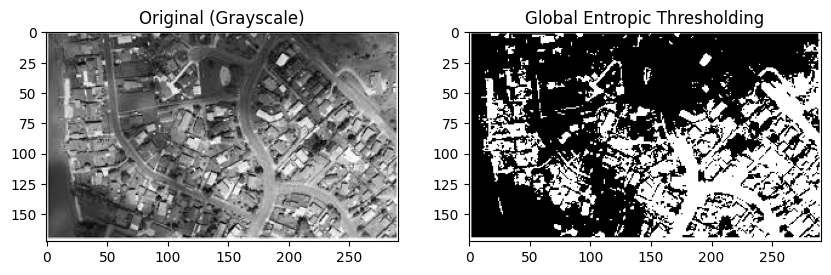

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def entropic_threshold(hist):
    """Find the threshold that maximizes the sum of foreground and background entropies."""
    hist = hist.astype(np.float32)
    hist /= hist.sum()  # Normalize to make a probability distribution

    cumsum = np.cumsum(hist)
    entropy_total = np.zeros_like(hist)

    for T in range(1, len(hist)):
        # Background
        p0 = hist[:T]
        c0 = cumsum[T-1]
        if c0 > 0:
            entropy_bkg = -np.sum((p0 / c0) * np.log(p0 / c0 + 1e-12))
        else:
            entropy_bkg = 0

        # Foreground
        p1 = hist[T:]
        c1 = 1.0 - c0
        if c1 > 0:
            entropy_fgd = -np.sum((p1 / c1) * np.log(p1 / c1 + 1e-12))
        else:
            entropy_fgd = 0

        entropy_total[T] = entropy_bkg + entropy_fgd

    T_star = np.argmax(entropy_total)
    return T_star

def global_entropic_thresholding(image):
    """Apply global entropic thresholding to the entire image."""
    hist = cv2.calcHist([image], [0], None, [256], [0, 256]).flatten()
    threshold = entropic_threshold(hist)
    binary = (image > threshold).astype(np.uint8) * 255
    return binary

# Example usage
img = cv2.imread('/content/shadow.jpg', cv2.IMREAD_GRAYSCALE)
result = global_entropic_thresholding(img)

# Display results
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title('Original (Grayscale)')
plt.imshow(img, cmap='gray')
plt.subplot(1, 2, 2)
plt.title('Global Entropic Thresholding')
plt.imshow(result, cmap='gray')
plt.show()


### But using a Global threshold does not give good results

### 📌 Why Global Thresholding Can Be Problematic

- **Assumes uniform lighting and contrast across the image.**
- Applies a **single threshold value** to the entire image.
- **Fails under real-world conditions** like:
  - Shadows
  - Varying brightness
  - Uneven illumination
- Can lead to:
  - Missed features in darker regions
  - Over-segmentation in brighter regions
  - Poor separation of objects and background

Hence there is a need of dynamic thresholding over different resgions of the image
---

### ✅ Why Use Dynamic (Local) Entropic Thresholding

- **Adapts threshold locally** for each small region (block).
- Handles **non-uniform illumination** more robustly.
- Each block's threshold is computed **based on its own histogram**, preserving local structure.
- **Improves segmentation accuracy** in:
  - Road detection under shadows
  - Medical images with lighting variation
  - Any scene with mixed lighting conditions

---





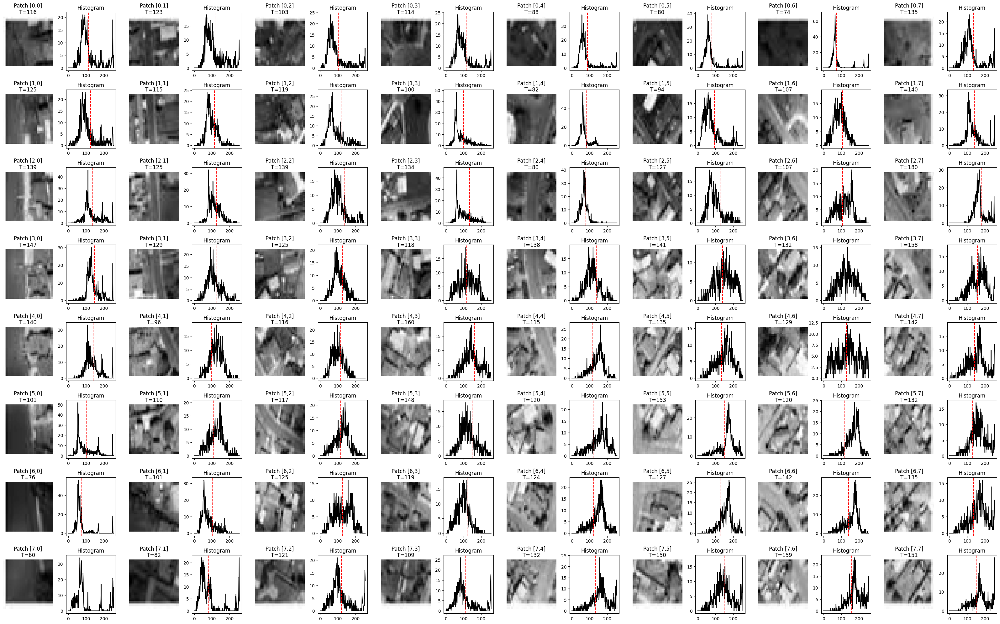

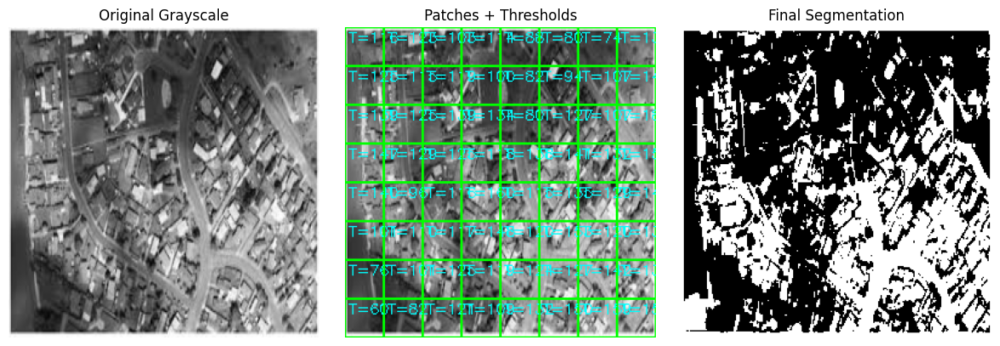

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# ---------- 1. Entropy-Based Thresholding ----------
def entropic_threshold(hist):
    hist = hist.astype(np.float32)
    hist /= hist.sum()
    cumsum = np.cumsum(hist)
    entropy_total = np.zeros_like(hist)

    for T in range(1, len(hist)):
        p0 = hist[:T]
        c0 = cumsum[T - 1]
        if c0 > 0:
            entropy_bkg = -np.sum((p0 / c0) * np.log(p0 / c0 + 1e-12))
        else:
            entropy_bkg = 0

        p1 = hist[T:]
        c1 = 1.0 - c0
        if c1 > 0:
            entropy_fgd = -np.sum((p1 / c1) * np.log(p1 / c1 + 1e-12))
        else:
            entropy_fgd = 0

        entropy_total[T] = entropy_bkg + entropy_fgd

    T_star = np.argmax(entropy_total)
    return T_star

# ---------- 2. Divide Image and Get Patch Thresholds ----------
def compute_patch_thresholds(image, block_size):
    h, w = image.shape
    h_blocks = h // block_size[0]
    w_blocks = w // block_size[1]

    thresholds = []
    segmented = np.zeros_like(image)

    for i in range(h_blocks):
        row_thresholds = []
        for j in range(w_blocks):
            y0, y1 = i * block_size[0], (i + 1) * block_size[0]
            x0, x1 = j * block_size[1], (j + 1) * block_size[1]
            patch = image[y0:y1, x0:x1]

            hist = cv2.calcHist([patch], [0], None, [256], [0, 256]).flatten()
            T = entropic_threshold(hist)
            row_thresholds.append(T)

            # Apply segmentation
            binary_patch = (patch > T).astype(np.uint8) * 255
            segmented[y0:y1, x0:x1] = binary_patch
        thresholds.append(row_thresholds)

    return thresholds, segmented

# ---------- 3. Draw Patch Boundaries ----------
def draw_patch_grid(image, block_size, thresholds=None):
    img_color = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    h, w = image.shape
    h_blocks = h // block_size[0]
    w_blocks = w // block_size[1]

    for i in range(h_blocks):
        for j in range(w_blocks):
            y0, y1 = i * block_size[0], (i + 1) * block_size[0]
            x0, x1 = j * block_size[1], (j + 1) * block_size[1]
            cv2.rectangle(img_color, (x0, y0), (x1-1, y1-1), (0, 255, 0), 1)

            if thresholds:
                T = thresholds[i][j]
                cv2.putText(img_color, f"T={T}", (x0+3, y0+12),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0, 255, 255), 1)

    return img_color

# ---------- 4. Show Patches, Histograms and Thresholds ----------
def show_patches_histograms(image, thresholds, block_size):
    h, w = image.shape
    h_blocks = h // block_size[0]
    w_blocks = w // block_size[1]

    fig, axes = plt.subplots(h_blocks, w_blocks * 2, figsize=(w_blocks * 4, h_blocks * 2.5))
    axes = np.array(axes).reshape((h_blocks, w_blocks * 2))

    for i in range(h_blocks):
        for j in range(w_blocks):
            y0, y1 = i * block_size[0], (i + 1) * block_size[0]
            x0, x1 = j * block_size[1], (j + 1) * block_size[1]
            patch = image[y0:y1, x0:x1]
            hist = cv2.calcHist([patch], [0], None, [256], [0, 256]).flatten()
            T = thresholds[i][j]

            # Show patch
            axes[i, j*2].imshow(patch, cmap='gray')
            axes[i, j*2].set_title(f"Patch [{i},{j}]\nT={T}")
            axes[i, j*2].axis('off')

            # Show histogram
            axes[i, j*2 + 1].plot(hist, color='black')
            axes[i, j*2 + 1].axvline(x=T, color='red', linestyle='--')
            axes[i, j*2 + 1].set_title("Histogram")

    plt.tight_layout()
    plt.show()

# ---------- 5. Full Pipeline Runner ----------
def run_segmentation_pipeline(image_path, block_size=(64, 64), resize_dim=(256, 256)):
    # Step 1: Load image and convert to grayscale
    img_rgb = cv2.imread(image_path)
    img_rgb = cv2.cvtColor(img_rgb, cv2.COLOR_BGR2RGB)
    img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    img_gray = cv2.resize(img_gray, resize_dim)

    thresholds, segmented = compute_patch_thresholds(img_gray, block_size)


    img_with_grid = draw_patch_grid(img_gray, block_size, thresholds)


    show_patches_histograms(img_gray, thresholds, block_size)


    plt.figure(figsize=(12, 4))
    plt.subplot(1, 3, 1)
    plt.title("Original Grayscale")
    plt.imshow(img_gray, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title("Patches + Thresholds")
    plt.imshow(img_with_grid)
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title("Final Segmentation")
    plt.imshow(segmented, cmap='gray')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# ---------- 6. Run Pipeline ----------
run_segmentation_pipeline('/content/shadow.jpg', block_size=(32,32), resize_dim=(256, 256))


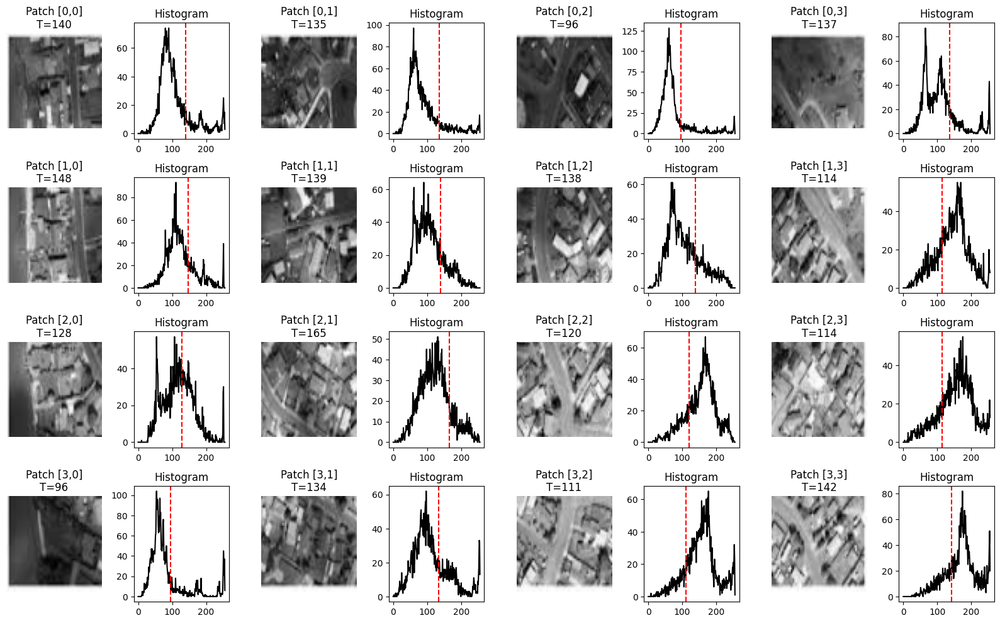

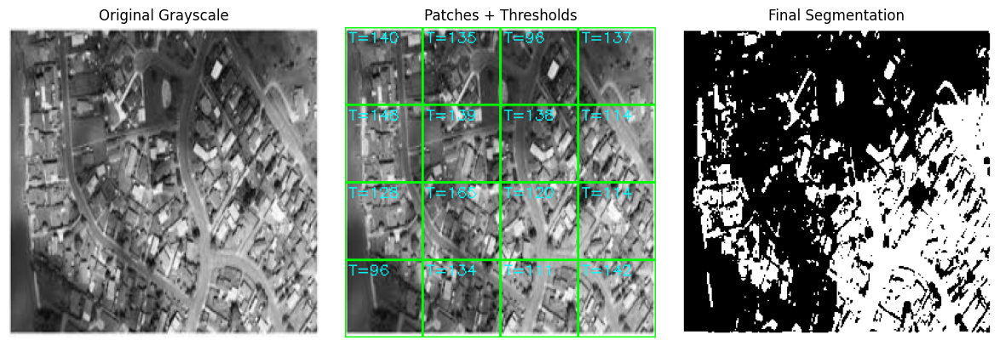

In [ ]:
run_segmentation_pipeline('/content/shadow.jpg', block_size=(64,64), resize_dim=(256, 256))

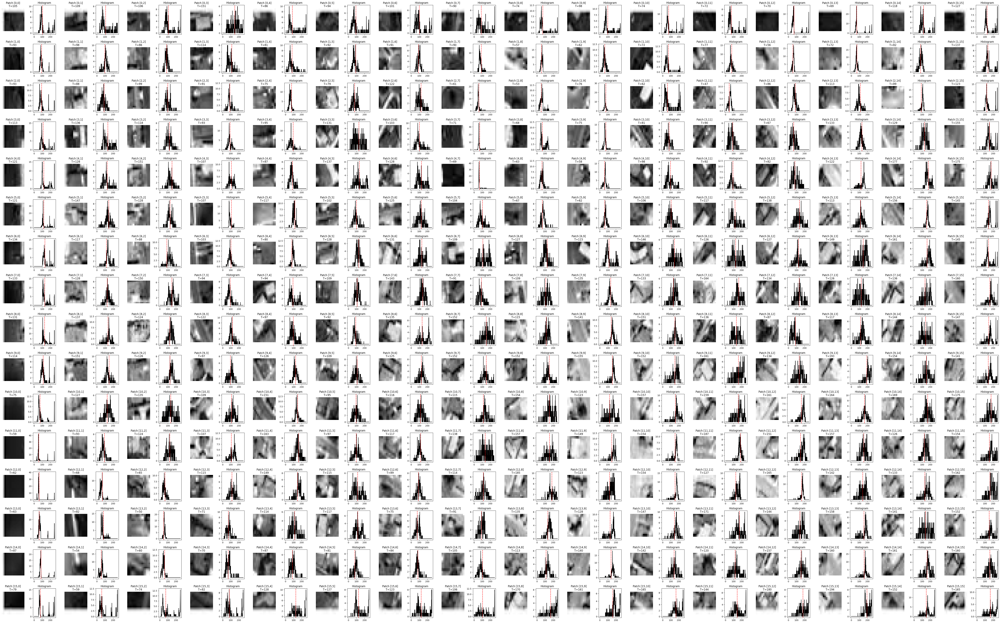

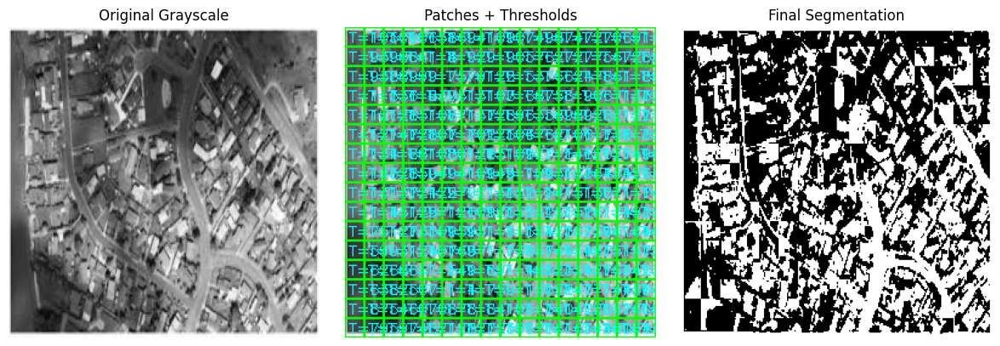

In [ ]:
run_segmentation_pipeline('/content/shadow.jpg', block_size=(16,16), resize_dim=(256, 256))

### 📌 Effect of Patch Size in Dynamic Entropic Thresholding

The **patch size (block size)** is a critical parameter in dynamic thresholding. It defines the size of the local region over which the entropy-based threshold is computed.

---

### 🔍 Why Patch Size Matters

- **Too large patch size**:
  - Behaves similarly to global thresholding.
  - Fails to adapt to local variations in lighting or texture.
  - May miss small-scale features or fine structures.

- **Too small patch size**:
  - Overfits to noise or small variations.
  - May produce fragmented or noisy segmentation.
  - Increases computation time.

---

### ⚖️ Trade-off Summary

| Patch Size       | Pros                                         | Cons                                          |
|------------------|----------------------------------------------|-----------------------------------------------|
| Large (e.g., 128×128) | Smooth segmentation, less noisy               | Misses fine details, poor in high-variation scenes |
| Small (e.g., 16×16)   | Captures fine details, adapts to shadows     | Noisy results, sensitive to artifacts           |
| Medium (e.g., 64×64)  | Balanced performance in most cases          | Trade-off between detail and smoothness         |

---

### ✅ Best Practices

- Choose patch size based on **image resolution and scene complexity**.
- For remote sensing images (512×512 or larger), typical patch sizes are:
  - 64×64 or 32×32 for urban areas with mixed objects.
  - 128×128 for flat or less textured scenes.

---

### 💡 Visual Insight

> Smaller patches increase **local adaptivity** but may introduce noise.  
> Larger patches offer **stability** but reduce sensitivity to **local features**.


## Case Study: Road extraction on DeepGlobe dataset using dynamic thresholding

📌 Motivation
The goal of this experiment is to explore the effectiveness of dynamic thresholding using entropy-based methods for the task of road extraction from satellite imagery. The DeepGlobe Road Extraction dataset provides high-resolution aerial images with pixel-level binary annotations for road networks, making it a valuable benchmark for segmentation tasks.

Most successful road segmentation methods today rely on deep learning, which requires large amounts of labeled data, computational resources, and training time. However, in many real-world or resource-constrained environments, it may be useful to evaluate lightweight, unsupervised, and interpretable methods that do not require training. This leads to our interest in entropy-based thresholding, a classic statistical method rooted in information theory.

---

🔧 Preprocessing and Approach
To enhance road-like structures before thresholding, we applied a top-hat morphological filter, which emphasizes thin, bright features such as roads. This is further combined with Canny edge detection to highlight high-contrast linear edges, and the combined image is then segmented using the dynamic entropic thresholding algorithm.

The pipeline is:

RGB → Grayscale → Top-hat + Canny → Patch-wise Entropic Thresholding → Binary Segmentation Mask




**This method provides a transparent baseline to understand how local contrast influences segmentation.**

---

🧠 Conclusion
Dynamic entropic thresholding is not a replacement for deep models in road extraction, but it is a useful, zero-training method for quick segmentation, weak supervision, or prototyping. Its strength lies in its simplicity, speed, and local adaptability, making it valuable in scenarios where data, computation, or annotations are limited.



Found 40 images.
562_sat.jpg: P=0.023 R=0.421 F1=0.043 IoU=0.022


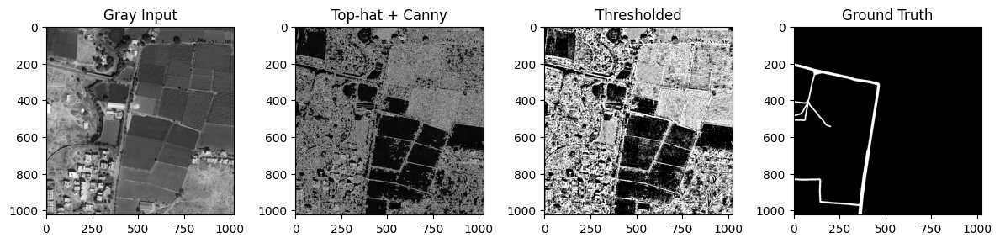

655_sat.jpg: P=0.042 R=0.681 F1=0.079 IoU=0.041


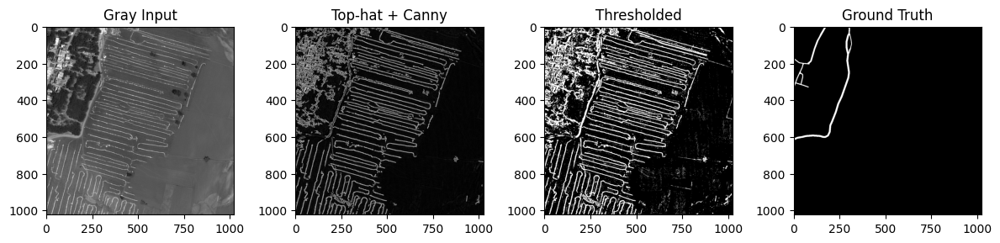

3573_sat.jpg: P=0.066 R=0.562 F1=0.118 IoU=0.063


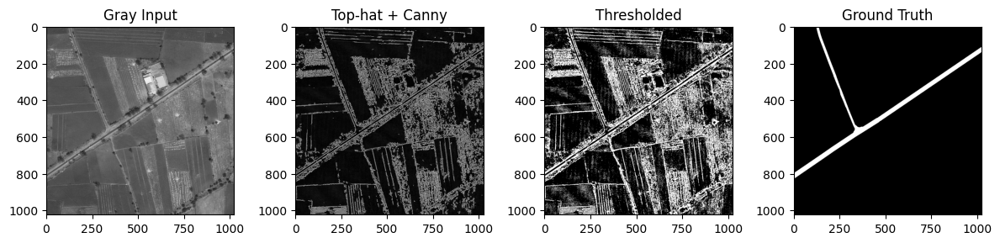

2129_sat.jpg: P=0.193 R=0.360 F1=0.251 IoU=0.144


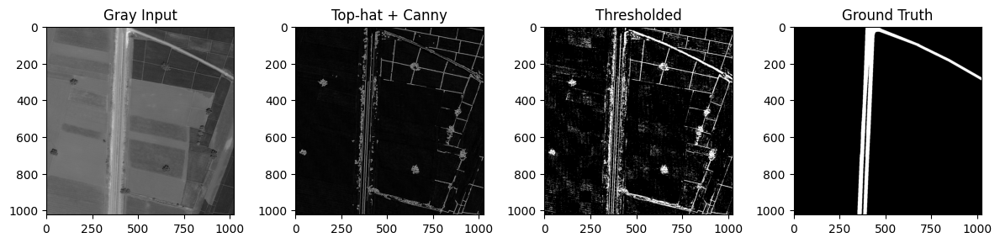

627_sat.jpg: P=0.043 R=0.518 F1=0.079 IoU=0.041


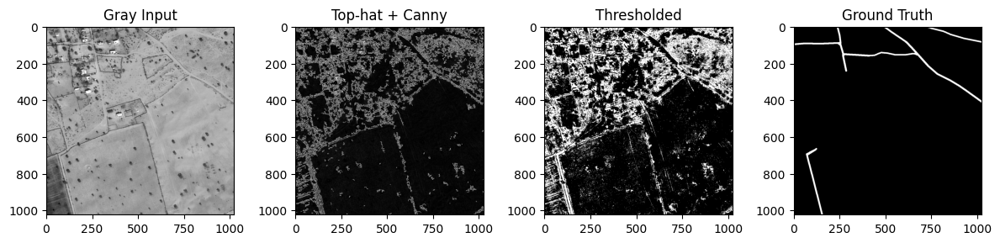

5279_sat.jpg: P=0.058 R=0.294 F1=0.097 IoU=0.051


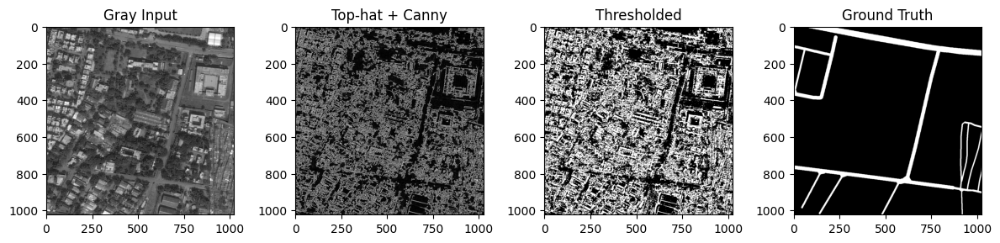

388_sat.jpg: P=0.020 R=0.615 F1=0.039 IoU=0.020


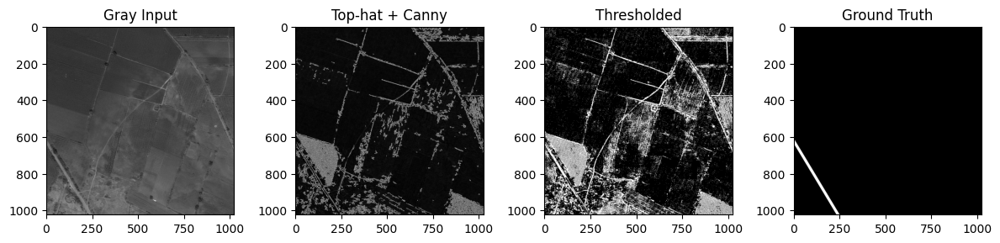

2730_sat.jpg: P=0.041 R=0.864 F1=0.079 IoU=0.041


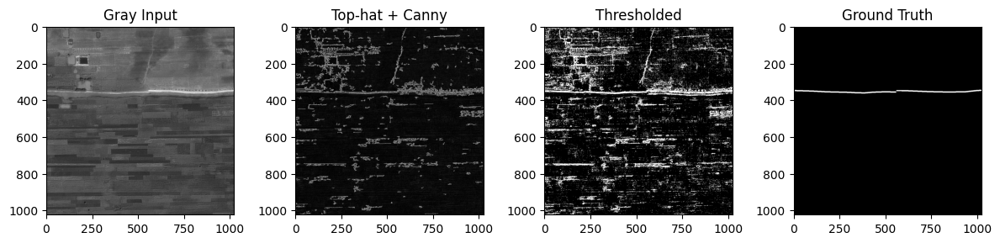

113_sat.jpg: P=0.028 R=0.464 F1=0.053 IoU=0.027


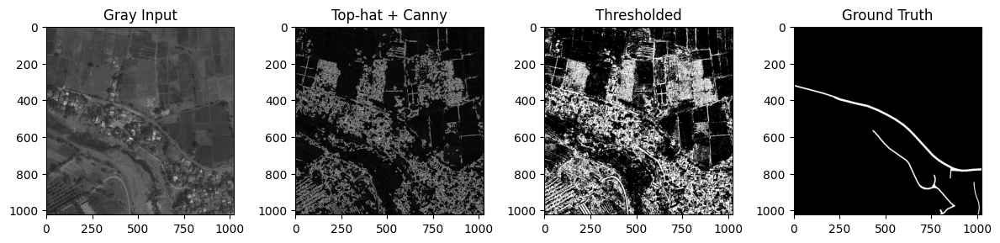

5555_sat.jpg: P=0.031 R=0.286 F1=0.056 IoU=0.029


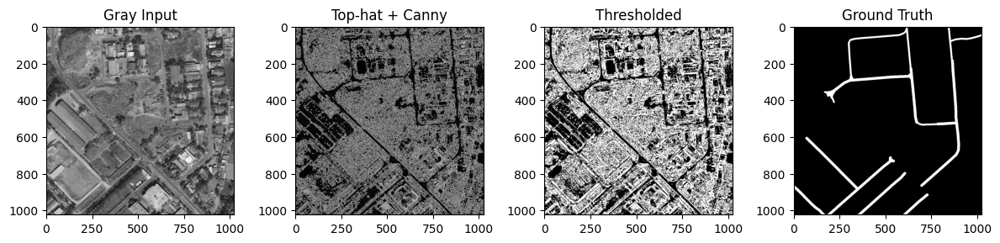

104_sat.jpg: P=0.021 R=0.321 F1=0.039 IoU=0.020


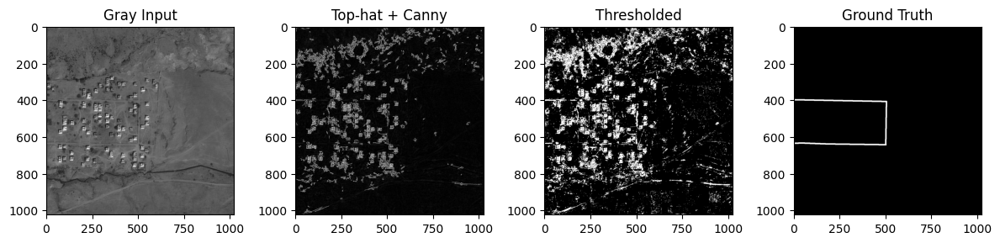

5668_sat.jpg: P=0.086 R=0.342 F1=0.138 IoU=0.074


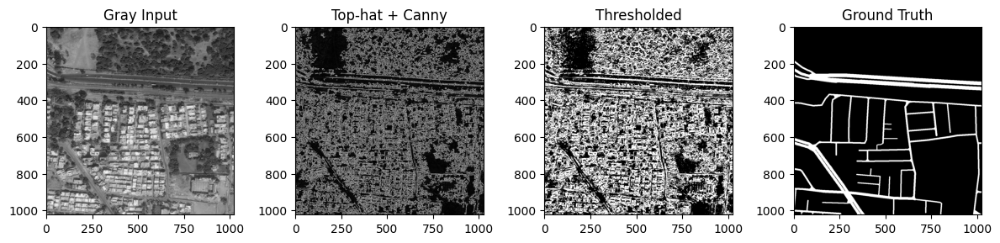

4209_sat.jpg: P=0.034 R=0.585 F1=0.065 IoU=0.033


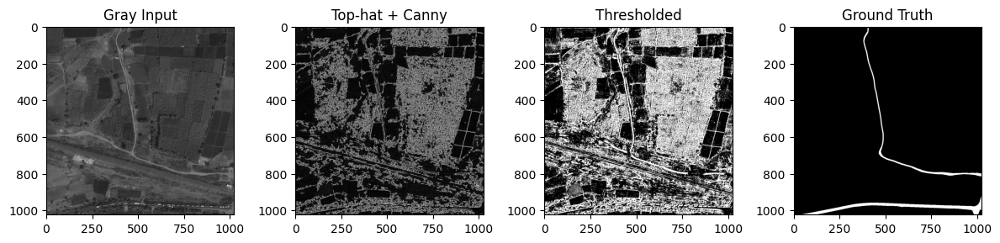

2262_sat.jpg: P=0.039 R=0.692 F1=0.074 IoU=0.038


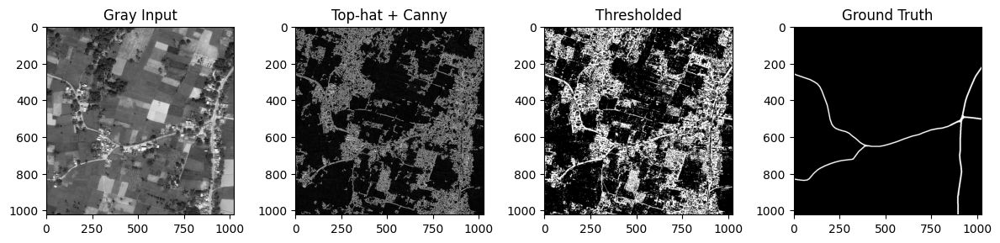

5415_sat.jpg: P=0.012 R=0.738 F1=0.024 IoU=0.012


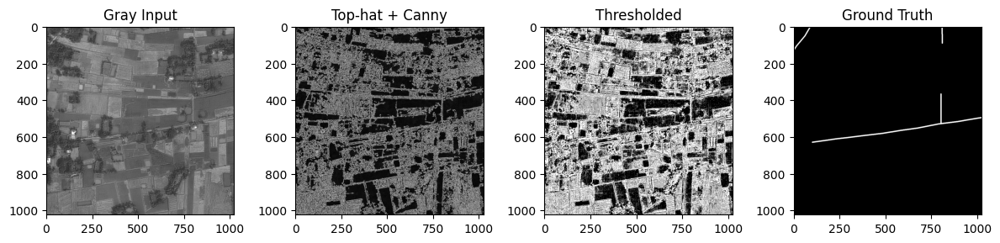

3530_sat.jpg: P=0.064 R=0.697 F1=0.117 IoU=0.062


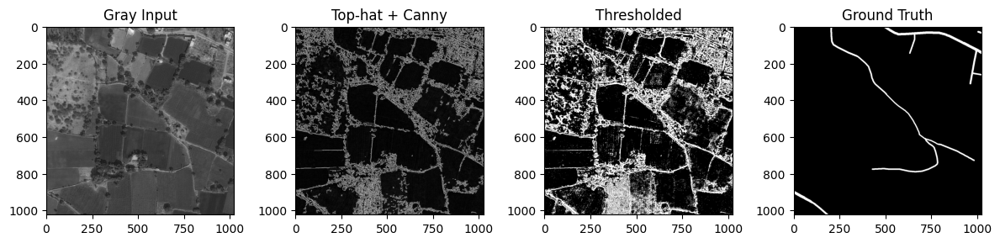

4131_sat.jpg: P=0.030 R=0.545 F1=0.057 IoU=0.030


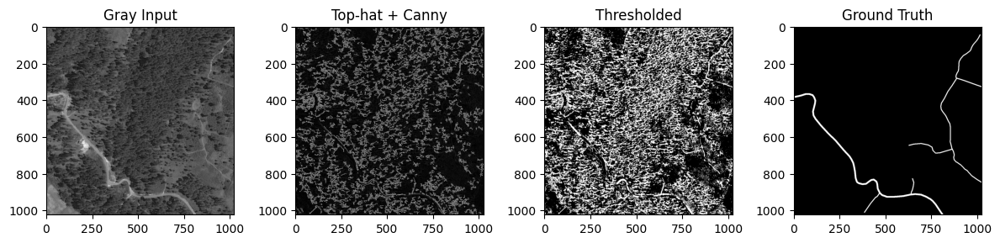

1054_sat.jpg: P=0.012 R=0.221 F1=0.023 IoU=0.011


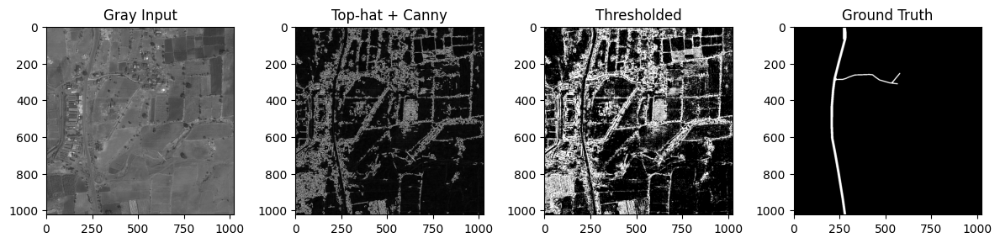

4227_sat.jpg: P=0.093 R=0.373 F1=0.149 IoU=0.081


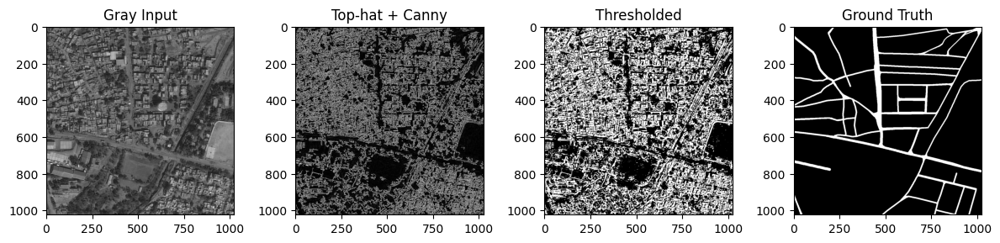

1945_sat.jpg: P=0.075 R=0.493 F1=0.131 IoU=0.070


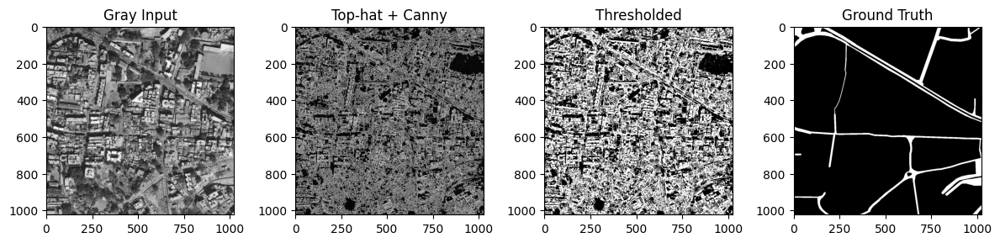

5740_sat.jpg: P=0.030 R=0.430 F1=0.056 IoU=0.029


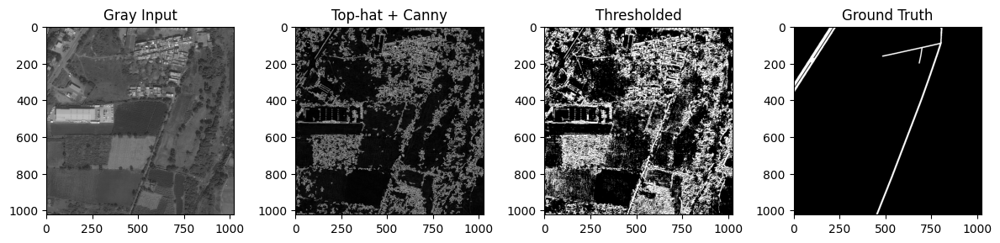

4301_sat.jpg: P=0.051 R=0.443 F1=0.091 IoU=0.048


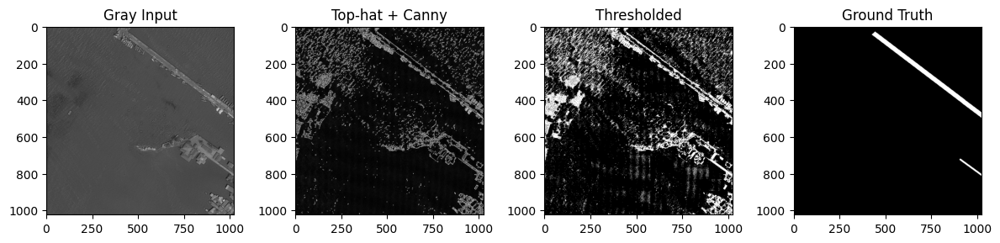

1934_sat.jpg: P=0.043 R=0.860 F1=0.081 IoU=0.042


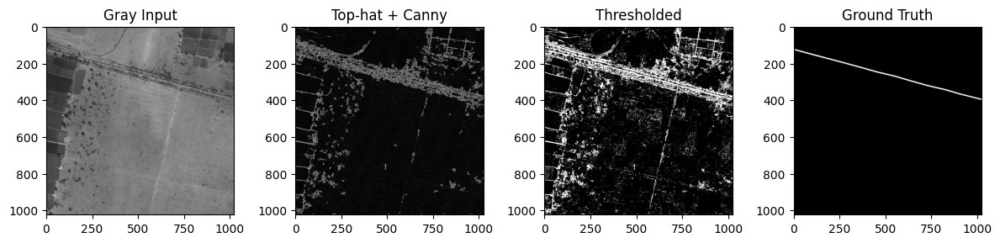

343_sat.jpg: P=0.015 R=0.699 F1=0.030 IoU=0.015


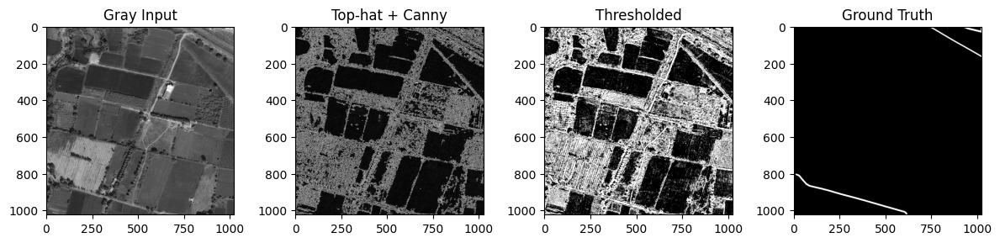

3452_sat.jpg: P=0.043 R=0.208 F1=0.071 IoU=0.037


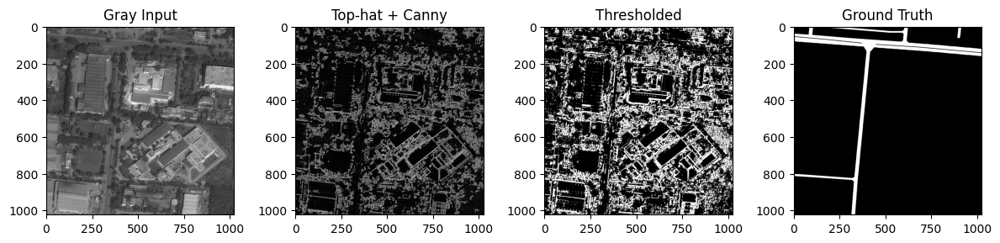

5523_sat.jpg: P=0.097 R=0.688 F1=0.170 IoU=0.093


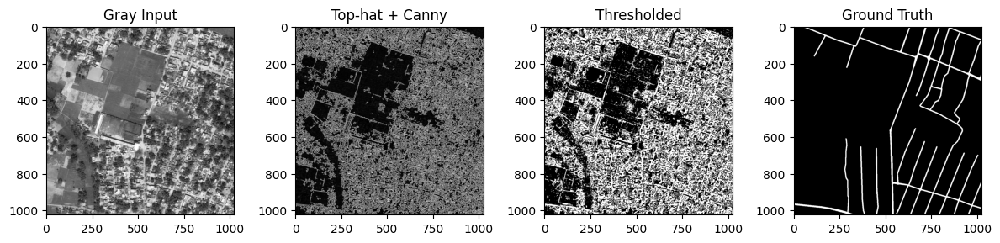

541_sat.jpg: P=0.028 R=0.259 F1=0.050 IoU=0.026


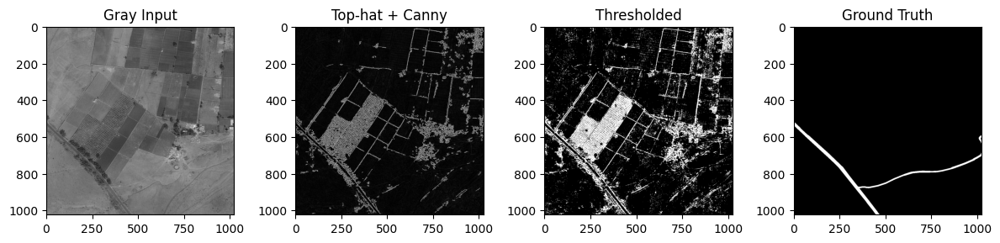

2667_sat.jpg: P=0.087 R=0.401 F1=0.143 IoU=0.077


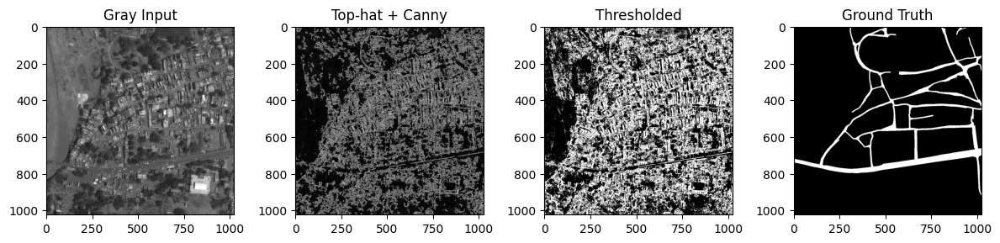

2647_sat.jpg: P=0.068 R=0.943 F1=0.127 IoU=0.068


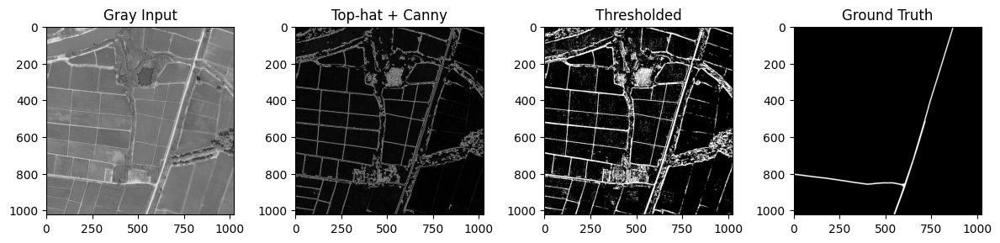

602_sat.jpg: P=0.032 R=0.539 F1=0.061 IoU=0.031


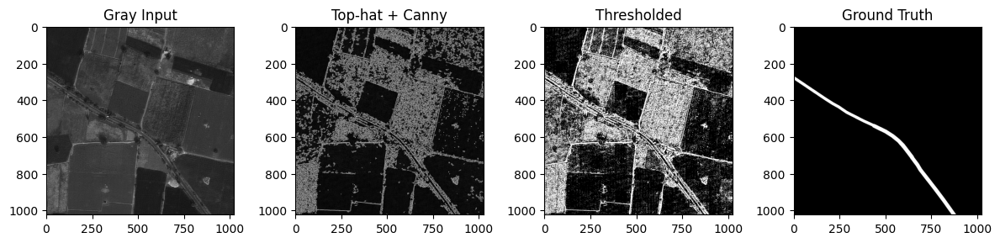

1849_sat.jpg: P=0.086 R=0.411 F1=0.143 IoU=0.077


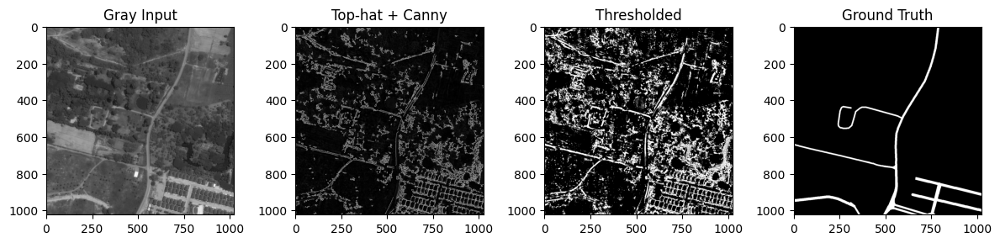

3602_sat.jpg: P=0.019 R=0.745 F1=0.038 IoU=0.019


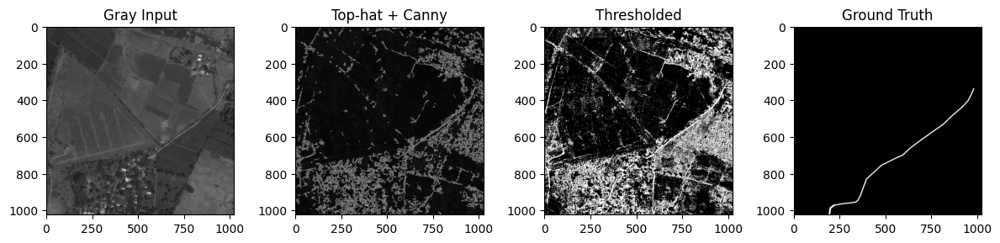

4163_sat.jpg: P=0.056 R=0.810 F1=0.105 IoU=0.055


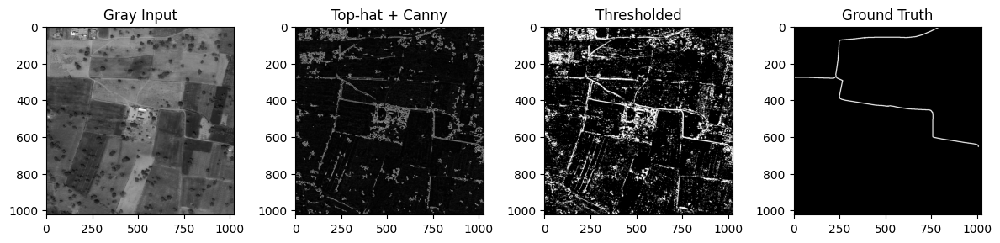

3280_sat.jpg: P=0.081 R=0.626 F1=0.144 IoU=0.078


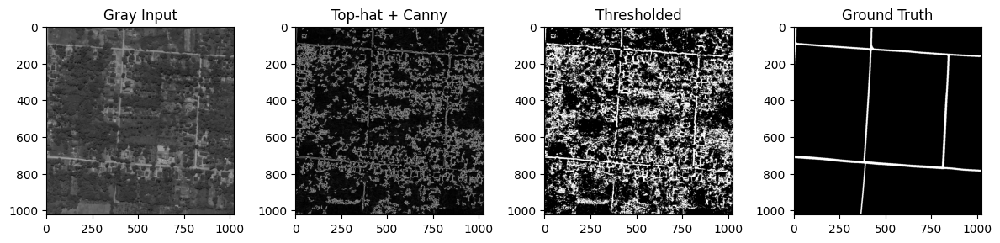

4903_sat.jpg: P=0.057 R=0.813 F1=0.106 IoU=0.056


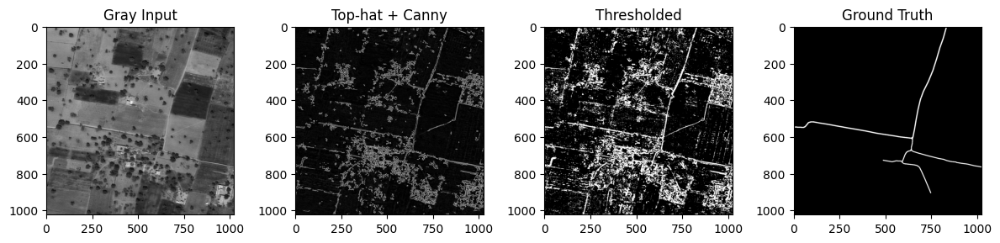

3594_sat.jpg: P=0.080 R=0.197 F1=0.114 IoU=0.060


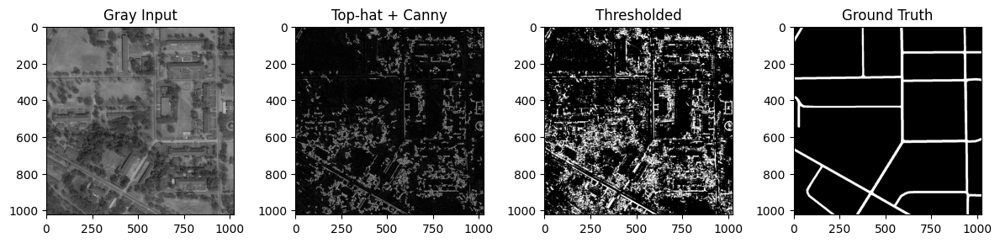

5501_sat.jpg: P=0.043 R=0.158 F1=0.068 IoU=0.035


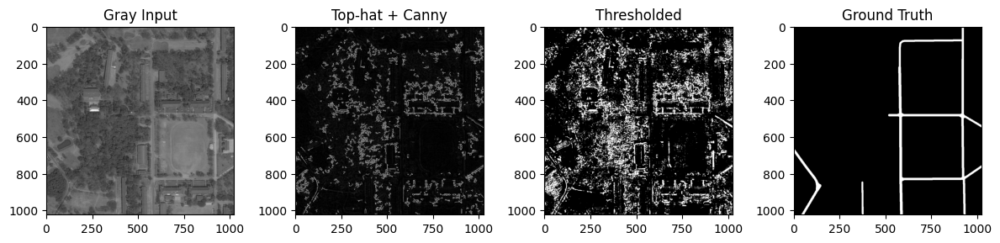

2495_sat.jpg: P=0.092 R=0.639 F1=0.162 IoU=0.088


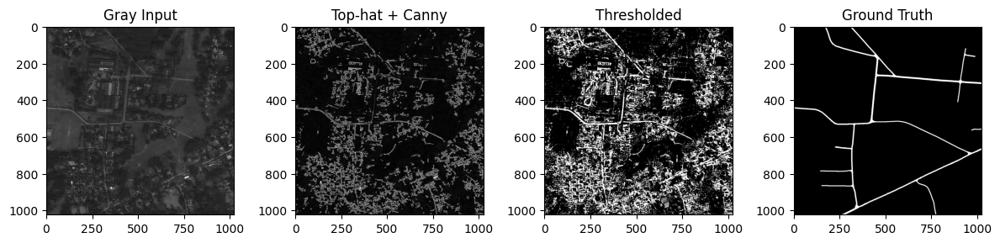

5386_sat.jpg: P=0.026 R=0.762 F1=0.049 IoU=0.025


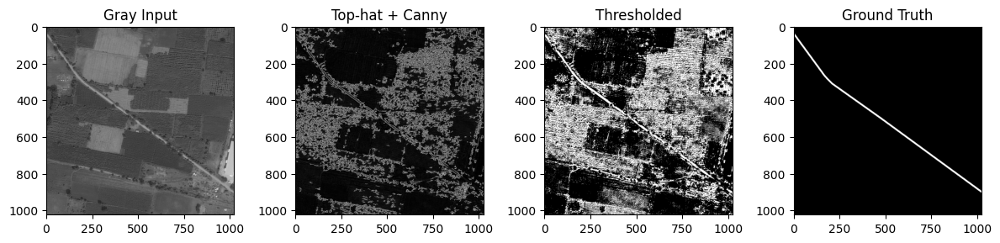

951_sat.jpg: P=0.041 R=0.398 F1=0.074 IoU=0.038


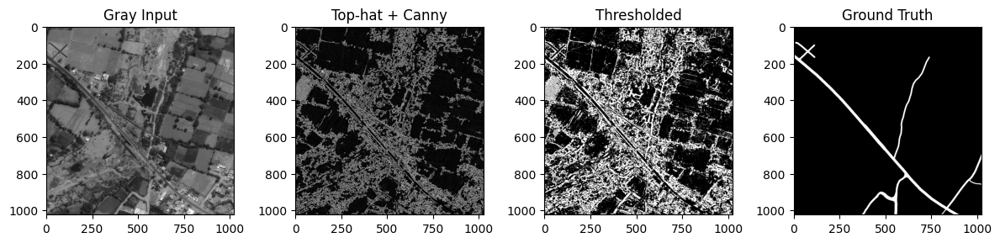


--- Average Performance ---
Precision: 0.052
Recall:    0.527
F1-Score:  0.090
IoU:       0.048


In [ ]:
import os
import cv2
import numpy as np
from sklearn.metrics import precision_score, recall_score, f1_score, jaccard_score
import matplotlib.pyplot as plt


def entropic_threshold(hist):
    hist = hist.astype(np.float32)
    hist /= hist.sum()
    cumsum = np.cumsum(hist)
    entropy_total = np.zeros_like(hist)

    for T in range(1, len(hist)):
        p0 = hist[:T]
        c0 = cumsum[T - 1]
        entropy_bkg = -np.sum((p0 / c0) * np.log(p0 / c0 + 1e-12)) if c0 > 0 else 0
        p1 = hist[T:]
        c1 = 1.0 - c0
        entropy_fgd = -np.sum((p1 / c1) * np.log(p1 / c1 + 1e-12)) if c1 > 0 else 0
        entropy_total[T] = entropy_bkg + entropy_fgd

    return np.argmax(entropy_total)


def dynamic_entropic_thresholding(image, block_size=(64, 64)):
    h, w = image.shape
    output = np.zeros_like(image)

    for i in range(0, h, block_size[0]):
        for j in range(0, w, block_size[1]):
            block = image[i:i + block_size[0], j:j + block_size[1]]
            if block.size == 0:
                continue
            hist = cv2.calcHist([block], [0], None, [256], [0, 256]).flatten()
            threshold = entropic_threshold(hist)
            binary_block = (block > threshold).astype(np.uint8) * 255
            output[i:i + block_size[0], j:j + block_size[1]] = binary_block

    return output


def preprocess_tophat_canny(gray_image):
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (11, 11))
    tophat = cv2.morphologyEx(gray_image, cv2.MORPH_TOPHAT, kernel)
    canny = cv2.Canny(tophat, 50, 150)
    combined = cv2.bitwise_or(tophat, canny)
    return combined


def evaluate(pred_mask, true_mask):
    pred_flat = pred_mask.flatten() // 255
    true_flat = true_mask.flatten() // 255
    precision = precision_score(true_flat, pred_flat, zero_division=0)
    recall = recall_score(true_flat, pred_flat, zero_division=0)
    f1 = f1_score(true_flat, pred_flat, zero_division=0)
    iou = jaccard_score(true_flat, pred_flat, zero_division=0)
    return precision, recall, f1, iou


def visualize_steps(gray, enhanced, pred, gt):
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 4, 1); plt.imshow(gray, cmap='gray'); plt.title("Gray Input")
    plt.subplot(1, 4, 2); plt.imshow(enhanced, cmap='gray'); plt.title("Top-hat + Canny")
    plt.subplot(1, 4, 3); plt.imshow(pred, cmap='gray'); plt.title("Thresholded")
    plt.subplot(1, 4, 4); plt.imshow(gt, cmap='gray'); plt.title("Ground Truth")
    plt.tight_layout()
    plt.show()


def run_dynamic_segmentation(folder_path, block_size=(64, 64)):
    image_files = [f for f in os.listdir(folder_path) if f.endswith('_sat.jpg') or f.endswith('_sat.png')]
    print(f"Found {len(image_files)} images.")

    results = []

    for img_file in image_files:
        mask_file = img_file.replace('_sat.jpg', '_mask.png').replace('_sat.png', '_mask.png')
        img_path = os.path.join(folder_path, img_file)
        mask_path = os.path.join(folder_path, mask_file)

        if not os.path.exists(mask_path):
            print(f"Missing mask for {img_file}, skipping...")
            continue

        img = cv2.imread(img_path)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        gt_mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        gt_mask = cv2.resize(gt_mask, gray.shape[::-1])
        gt_mask = (gt_mask > 127).astype(np.uint8) * 255


        enhanced = preprocess_tophat_canny(gray)


        pred_mask = dynamic_entropic_thresholding(enhanced, block_size)


        precision, recall, f1, iou = evaluate(pred_mask, gt_mask)
        results.append((img_file, precision, recall, f1, iou))

        print(f"{img_file}: P={precision:.3f} R={recall:.3f} F1={f1:.3f} IoU={iou:.3f}")


        visualize_steps(gray, enhanced, pred_mask, gt_mask)


    if results:
        avg = np.array([[p, r, f, i] for _, p, r, f, i in results]).mean(axis=0)
        print("\n--- Average Performance ---")
        print(f"Precision: {avg[0]:.3f}")
        print(f"Recall:    {avg[1]:.3f}")
        print(f"F1-Score:  {avg[2]:.3f}")
        print(f"IoU:       {avg[3]:.3f}")


run_dynamic_segmentation("/content/dataset", block_size=(64, 64))


📊 Analysis and Observations
While this method is fast, unsupervised, and interpretable, it does not leverage semantic understanding, which limits its ability to distinguish roads from visually similar structures (e.g., rooftops, trails).

The results show that some road segments are successfully detected, especially those with strong contrast and alignment, but many are missed due to local intensity variations or cluttered surroundings.

IoU, Precision, and F1 scores are low, which is expected given the lack of learning or context modeling.

However, the qualitative results show that this method:

Works surprisingly well in rural or sparse environments with clear road patterns.

Can be used as a baseline or preprocessing step for more advanced models.

Is interpretable and lightweight, making it suitable for educational purposes or use on edge devices.

---

✅ Significance
Even though the results do not match learning-based models, this method:

Highlights the power of classical techniques when used carefully with good preprocessing.